# Proximal Denoising

To denoise an image, one can seek for a solution to the following optimization
problem :

\begin{equation}
argmin_{y \in \mathbb{R^n}} f(Ly)+\frac{||y-x||^2}{2} \ \ \ (1)
\end{equation}

where $y \in \mathbb{R^n}$ is the vector corresponding to the observed image which is corrupted by noise, $L \in \mathbb{R}^{N×N}$ is a suited orthogonal transform , and $f$ is a separable penalty function of the form :


$$ \forall u = (u_i)_{1\leq i \leq N} \in \mathbb{R^N}  \ \ \ f(u) = \sum_{i=1}^N f_i(u_i)$$

where $(\forall i ∈ \{1, . . . , N\}) f_i \in  \Gamma_0(R)$

## Question 1

Show that this problem amounts to calculate the proximity operator of a function in $\Gamma_0(\mathbb{R}^N)$

$$argmin_y f(Ly)+\frac{||y-x||^2}{2}= prox_{foL} (x) $$

The function $f$ is a convex and lower semi-continuos function since it is the finite sum of convex and lowersemi-continuos functions $f=\sum_{i=1}^n f_i$. The sum of proper functions is not necessarily a proper function, but we can add some hypothesis to guarantee this condition, for example that $\{f_i\}_{i in 1,..,n}$ share the same domain. 

As $Ly$ is an affine function, it is continuos and convex, then $foL$ is convex and lower semi-continuos. Addtionally, $Ly \in Dom(f)$ given the fact that $L$ is an orthogonal transformation, then $foL \in \Gamma_0(R)$.

In conclusion solving this optimization problem is equivalent to find the proximity operator of $foL \in \Gamma_0(R)$.

## Question 2

Check that this is also equivalent to calculate $L^{−1}prox_f(Ly)$

During the lectures, we prove the following result:

Let $H$ and $G$ be two Hilbert spaces. Let $f \in \Gamma(H)$ and $L\in B(G,H)$ such
that $LL^∗ = \mu Id$ where $\mu \in ]0,+∞[$. Then
$$prox_{f ◦L} = Id − \mu^{−1}L^∗ ◦ (Id − prox_{μf} ) ◦ L$$.

In our case $LL^*=Id$ as it is a orthogonal matrix, then using the previous result we have:
\begin{align}
prox_{f ◦L} & = Id − L^∗ ◦ (Id − prox_{f} ) ◦ L \\
&=Id − L^∗ ◦ Id ◦ L + L^∗ ◦ prox_{f} ◦ L \\
&= L^∗ ◦ prox_{f} ◦ L
\end{align}

In conclusion, we can compute $prox_{foL} (x)$ as $L^∗ prox_{f} Ly$.

## Question 3

Download the florence.jpg image. Add to this image a white Gaussian noise with zero-mean and standard deviation equal to 30

In [1]:
import numpy as np
import pywt
import cv2
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 

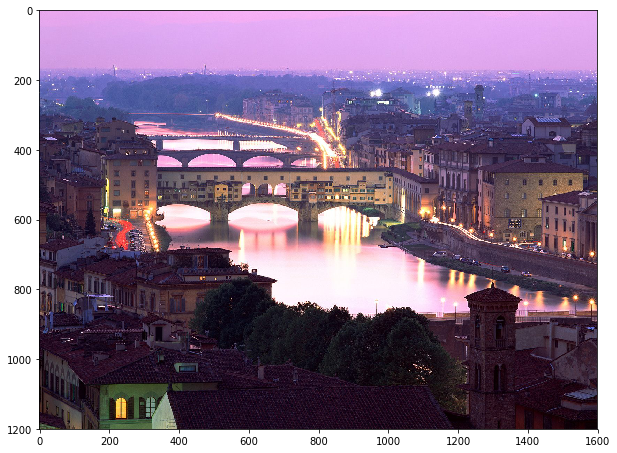

In [2]:
#### Loading Image
image_directory="C:\\Users\Fraintendetore\\Dropbox\\M2MVA\\Optimization big dimension\\"
image=cv2.imread(image_directory+"florence.jpg")
plt.figure(figsize=(10,30))
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()

### Image with noise

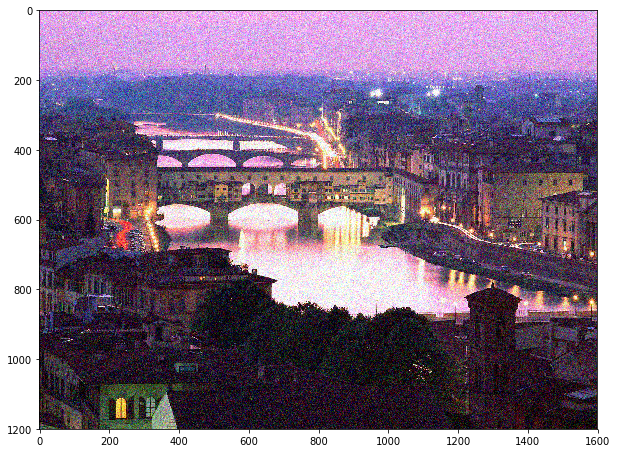

In [3]:
imagewithnoise=np.clip(image+np.random.normal(scale=30,size=image.shape),0,255)
imagewithnoise=np.uint8(imagewithnoise)
plt.figure(figsize=(10,30))
plt.imshow(cv2.cvtColor(imagewithnoise, cv2.COLOR_BGR2RGB))
plt.show()

## Question 4

Compute the minimizer of (1) when L is a 2D orthonormal wavelet decomposition. Recall that such a decomposition generates a set of so-called approximation coefficients and sets of detail coefficients defined at different resolutions. Consider the case when

$$\forall i \in \{1,...,N\} \ \ \ f_i = \begin{cases} 0 \ \ \text{si} \ \ i \in K \\ \psi \ \ \ \text{otherwise} \end{cases} $$


where $K$ is the index set of approximation coefficients, $\psi = \chi | · |^q$ with $q \in \{1, 4/3, 3/2, 2, 3, 4\}$, and $\chi \in (0, +∞)$ is a constant whose choice will be made in order to minimize the mean square estimation error

### Proximity Operator

In [39]:
def prox(x,regularization,k):
    
    assert k in [1,4./3.,3./2.,2,3,4], "Not proximity operator for that value of k"
    if k==1:
        p=np.sign(x)*np.where(np.abs(x)-regularization>0,np.abs(x)-regularization,0)
        return(p)
        
    if k==4./3.:
        e=np.sqrt(x**2+((256*regularization**3.)/729.))
        p=x+((4*regularization)/(3.2**(1./3.)))*((e-x)**(1./3.)-(e+x)**(1./3.))
        return(p)
    
    if k==3./2.:
        p=x+((9*np.sign(x)*regularization**2)/8)*(1-np.sqrt(1+((16*np.abs(x))/(9*regularization**2))))
        return(p)
    
    if k==2:
        p=x/(1+2*regularization)
        return(p)
     
    if k==3:
        p=np.sign(x)*(np.sqrt(1+12*regularization*np.abs(x))-1)/(6.*regularization)
        return(p)
        
    if k==4:
        e=np.sqrt(x**2+(1./(27.*regularization)))
        p=((e+x)/(8.*regularization))**(1./3.)-((e-x)/(8.*regularization))**(1./3.)
        return(p)

In [32]:
## Useful functions to visualize and denoising.

def denoise(imagewithnoise,mode,level,k,regularization):
    ### Funtion solving the optimization problem defined in 1.

    coeffs=pywt.wavedec2(imagewithnoise,wavelet=mode,level=level,axes=(0,1))
    coeffs=list(coeffs) 
    
    coeffs_all=[]
    coeffs_all.append(coeffs[0])
    for i in range(1,len(coeffs)):
        coeffs_all.append([prox(x,regularization,k) for x in coeffs[i]])
    imArray=pywt.waverec2(coeffs_all,mode,axes=(0,1))
    imArray = (1-(np.max(imArray)-imArray)/(np.max(imArray)-np.min(imArray)))*255
    Image_recover = np.uint8(imArray)
    return(Image_recover)
    
    
def compare(image,imagewithnoise,denoisedimage,title,changecolors=True):
    ### Function to compare the different images
    if changecolors==True:
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        imagewithnoise = cv2.cvtColor(imagewithnoise, cv2.COLOR_BGR2RGB)
        denoisedimage = cv2.cvtColor(denoisedimage, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(20,30))
    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.subplot(1, 3, 2)
    plt.imshow(imagewithnoise)
    plt.subplot(1, 3, 3)
    plt.imshow(denoisedimage)
    plt.title(title)
    plt.show()
    
def make_title(mode,level,regularization,k):
    return("Denoising with "+mode+" wavelet"+" at level="+str(level)+", regularization= "+str(regularization)+" and k="+str(k))

In this section, I analyze the effect of the different parameters in the model. This task is not trivial since the number of possible combinations is large and the parameters interact with each other in complex ways. As a consequence, the analysis I did is not exhaustive and the propossed denoising model could not be the best one.  

## The effect of the wavelet. 

As suggested in the lecture, I compare the Haar wavelet and the Daubechies wavelet with different number of vanishing moments. It turns out that the Haar wavelet is equivalent to a Daubechies wavelet with 2 vanishing moments.

The number of vanishing moments is related with the degree of the polynomials they are able to encode. The higher the vanishing moment, the higher the degree of the polynomials. In our exercise,the flexibility of the models is reflected in the opacity of the denoised image. 

In this example , we compare "db1","haar","db4","db8" and we fix the level of descomposition at 2, the parameter of regularization at 10 and the proximity operator at k=2. With this configuration, we can see how higher values of the vanishing moments generate more opaque images meaning they have problems to approximate some frequencies. Nevertheless, they reduce the noise effectively as they are more flexible models.

Under this configuration I found all results satisfying, but I preferred the results with "db1" and "db8"  so I will continue with these wavelets in the next experiments.

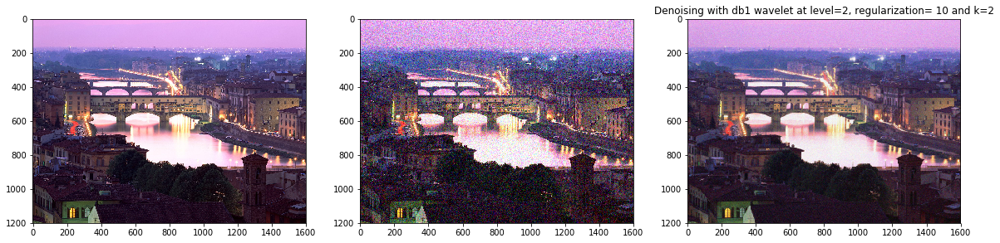

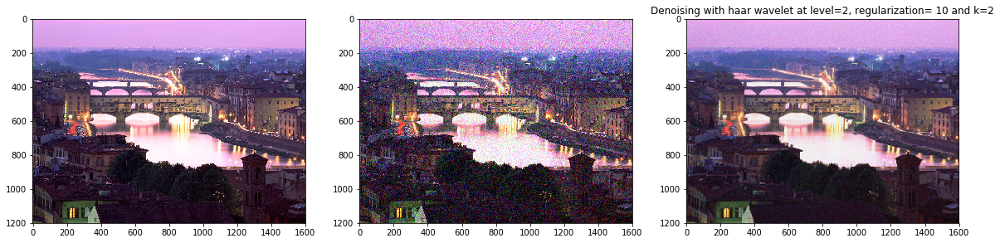

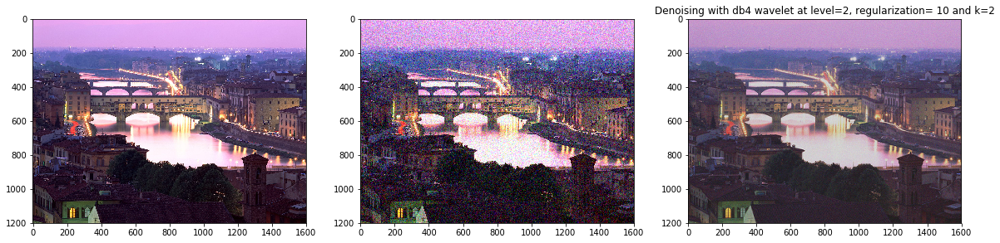

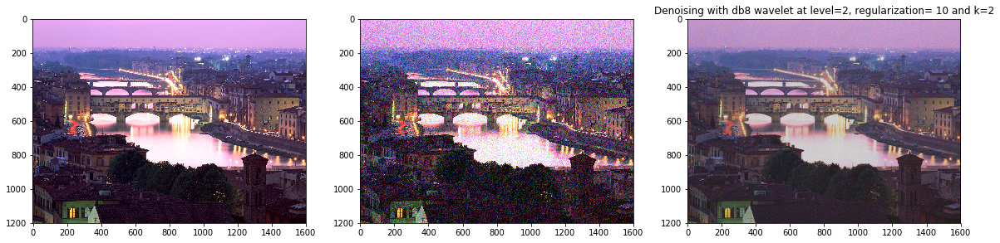

In [33]:
modes=["db1","haar","db4","db8"]
level=2
regularization=10
k=2 
for mode in modes:
    Image_recover=denoise(imagewithnoise,mode,level,k,regularization)
    compare(image,imagewithnoise,Image_recover,make_title(mode,level,regularization,k))

## The effect of the level of decomposition

The level of decomposition refers to the number of times the wavelet operation is applied to the approximation coefficients of the wavelet decomposition.

This time I fixed the parameters as mentioned previously, but with different levels of decomposition. It can be seen how increasing the level of decomposition improves the denoised image until a given point, where it starts to loss relevant information of the image. It is worthnoting that for a higher value of vanishing moments, the model is more resilient to accept a higher level of decomposition.

From the previous experiments and these ones, we could conclude that a good value of this parameter is 2.

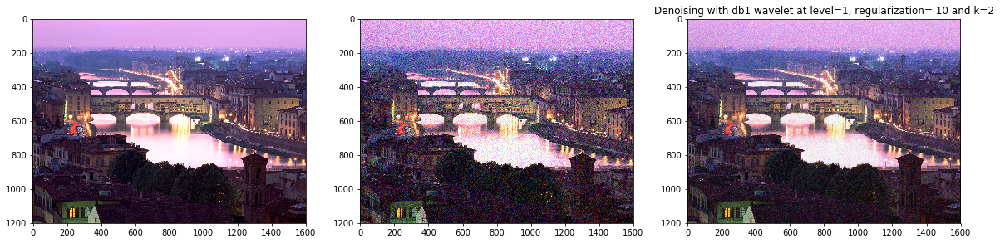

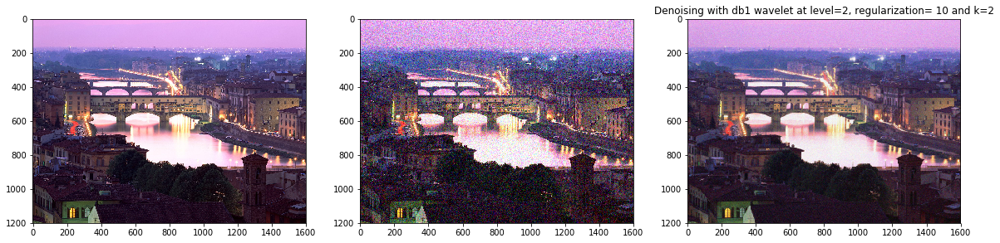

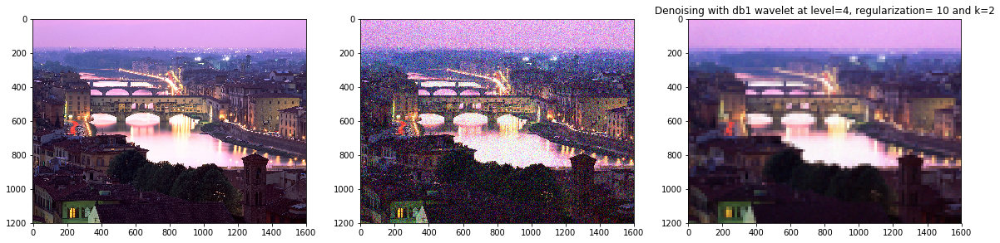

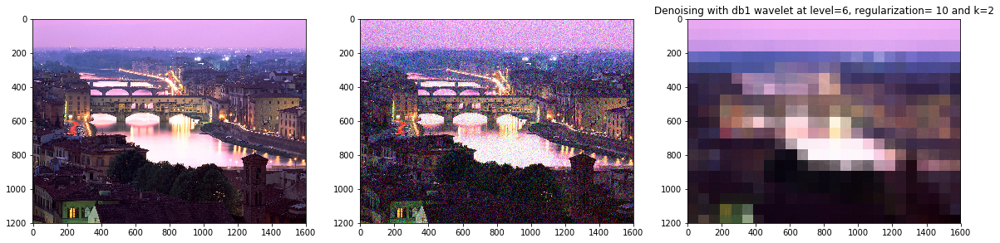

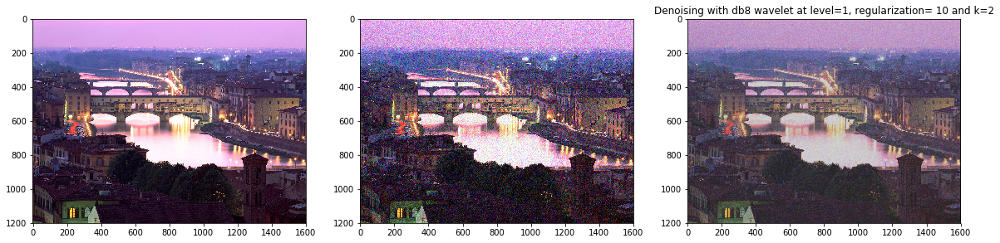

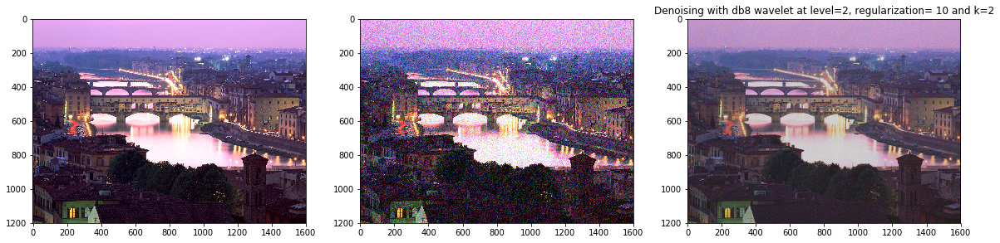

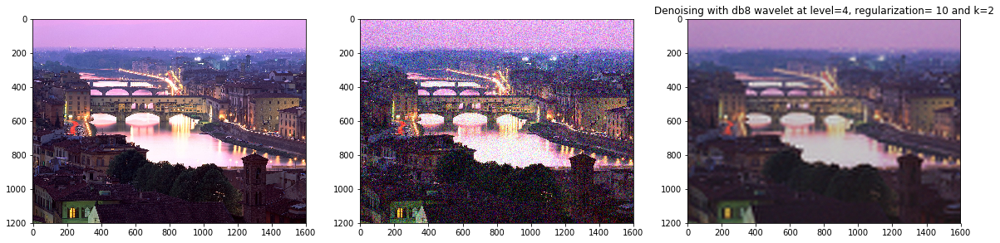

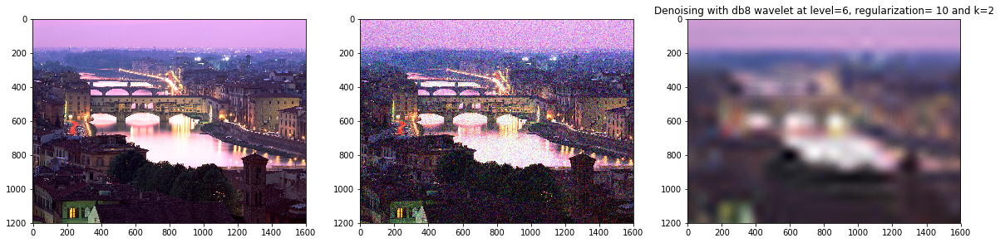

In [34]:
modes=["db1","db8"]
levels=[1,2,4,6]
regularization=10
k=2 
for mode in modes:
    for level in levels:
        Image_recover=denoise(imagewithnoise,mode,level,k,regularization)
        compare(image,imagewithnoise,Image_recover,make_title(mode,level,regularization,k))

## The effect of the proximator.

The function $f$ is the norm $k$ of a vector, this is the regularization term in the optimization problem. The parameter $k$ regulates the sparcity of the solution. Small values of this parameter will lear to sparcer solutions.It is important to mention that the sparcity of the solution will depend also on the regularization parameter that we will explore later.

In these experiments, I tried the different parameters of $k$ from which we computed the proximity operator. Sadly, the effects of a poor choice of these parameters can not be clearly perceived in this example.In general, a low value of $k$ can destroy the images by shinking too much the value of the pixels, and a high value of $k$ could not be able to filter the noise. 

We can deduce that good values of $k$ are bigger or equal than 2.

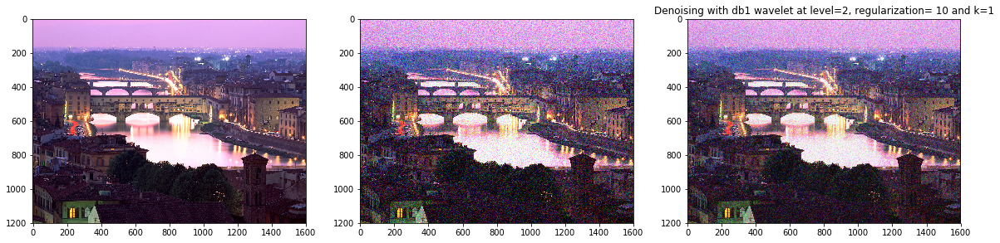

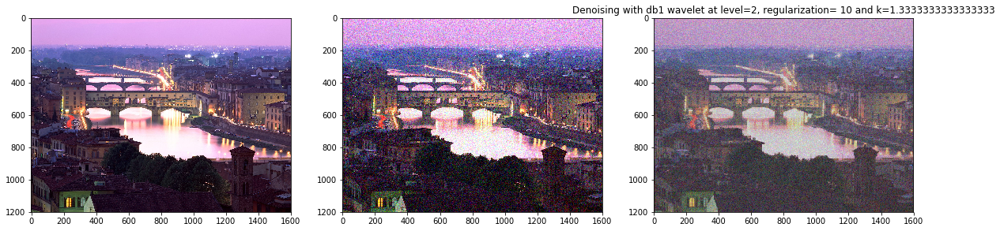

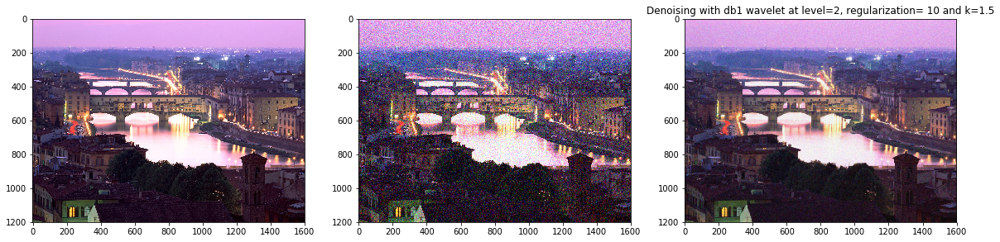

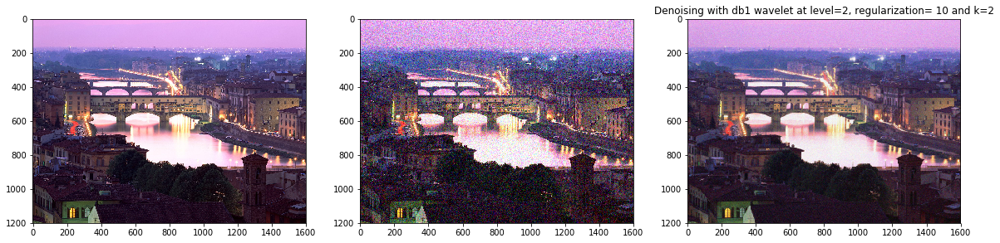

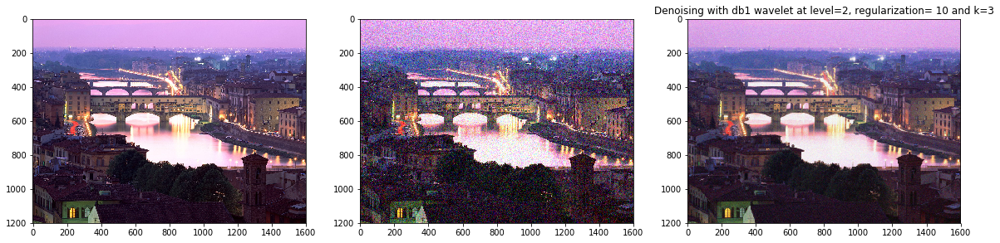

...

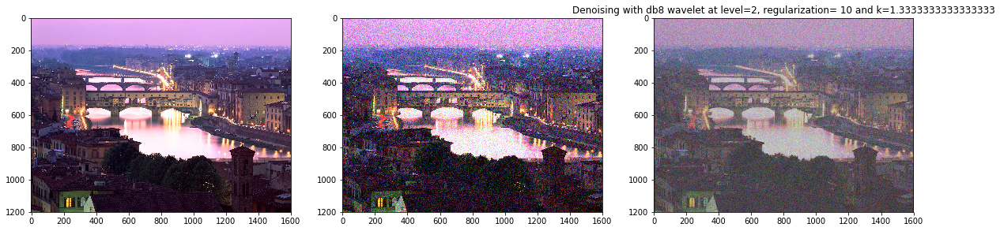

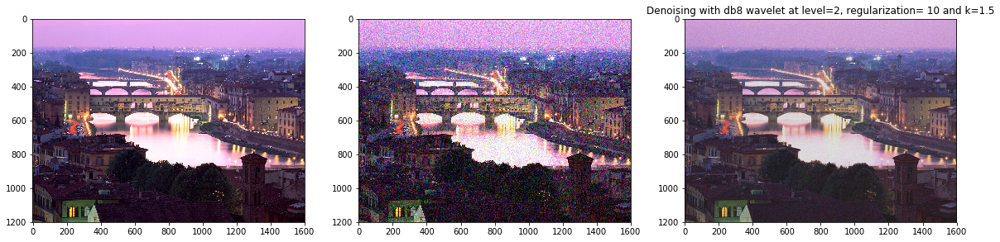

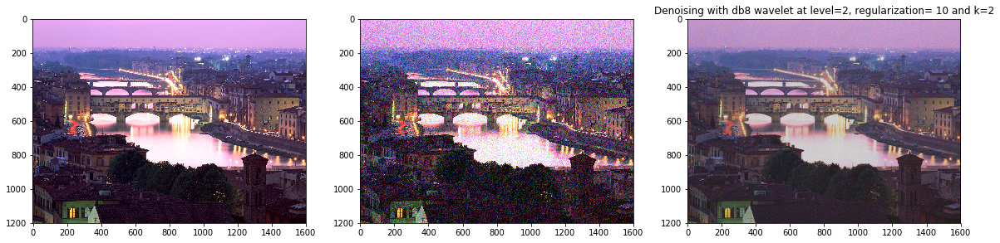

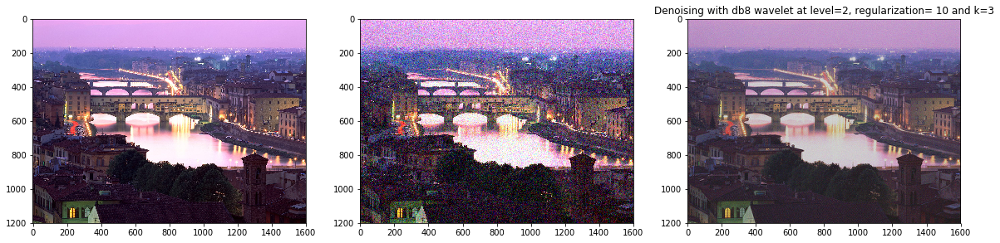

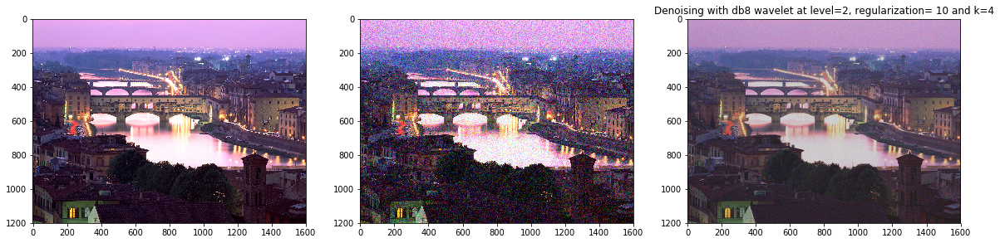

In [40]:
modes=["db1","db8"]
level=2
regularizations=10
ks=[1,4./3.,3./2.,2,3,4]
for mode in modes:
    for k in ks:
        Image_recover=denoise(imagewithnoise,mode,level,k,regularization)
        compare(image,imagewithnoise,Image_recover,make_title(mode,level,regularization,k))

## Effect of the regularization parameter.

The parameter $k$ interacts with the regularization parameter in the penalized term. In order to chosse a final model, I kept the db1 wavelet with a level 2 of decomposition and I tried different values of $k$ which gave good results in the last experiments and I interact with different regularization parameters.

As expected a low value of the regularization parameter could not be able to filter the noise. Very high values of this parameter can damage the image as the optimization problem suggests, but this effect was not observed in these experiments.

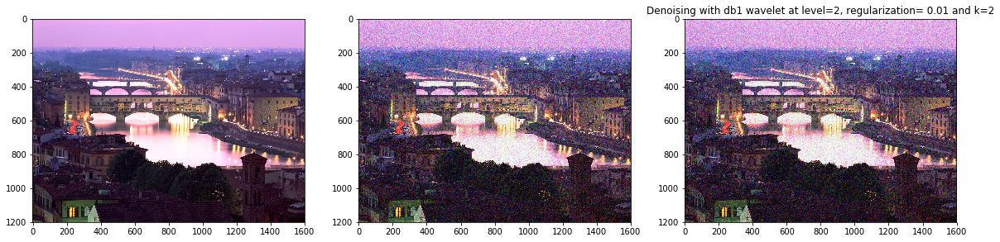

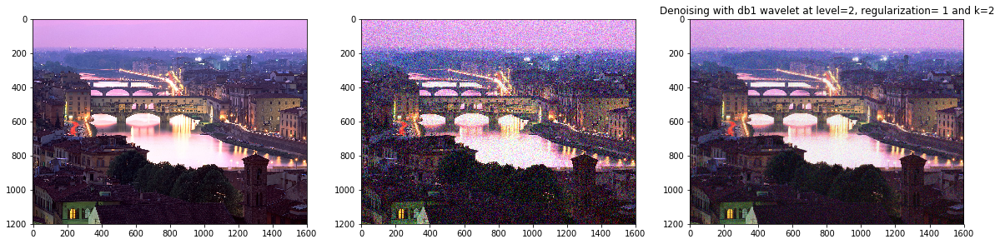

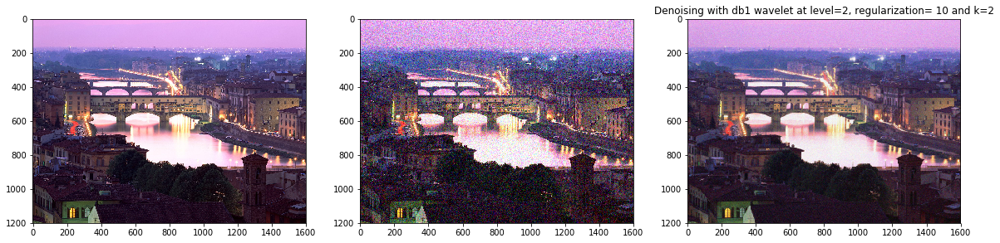

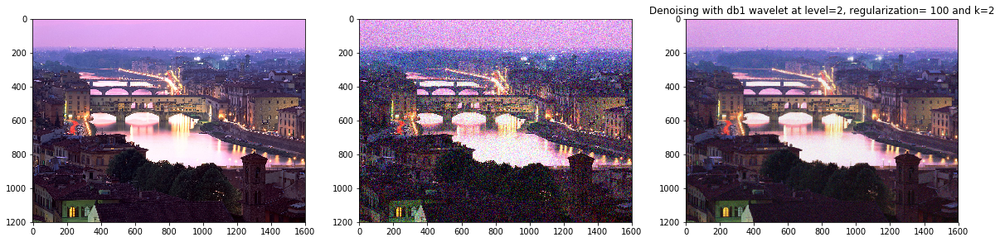

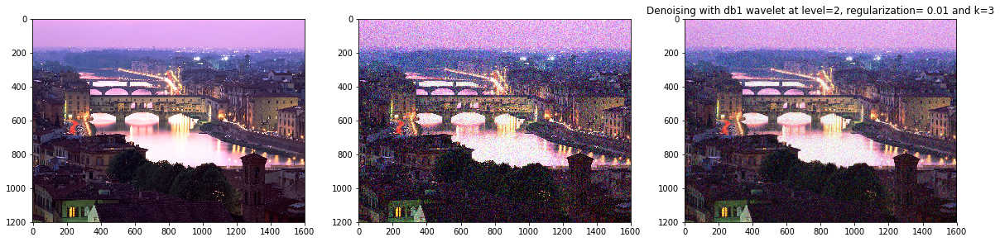

...

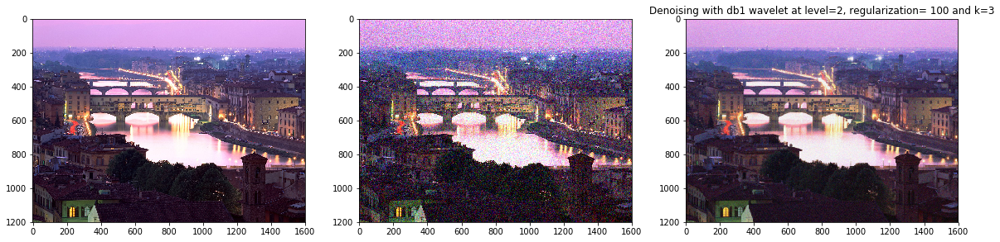

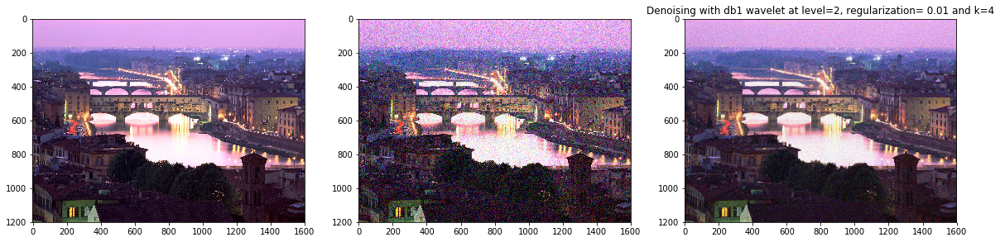

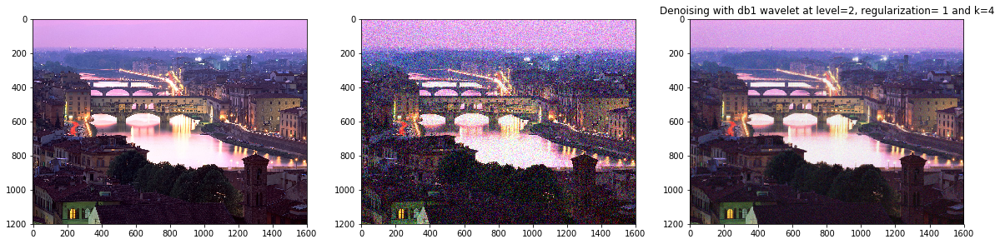

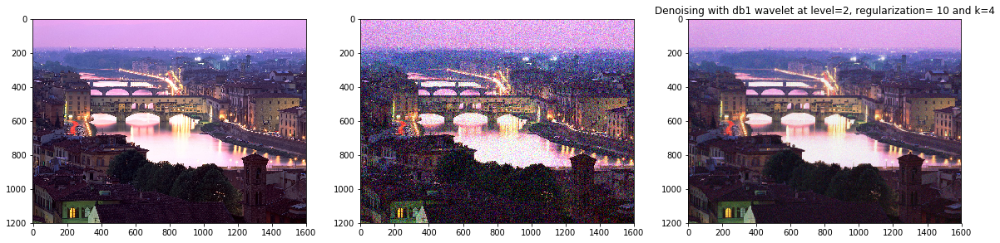

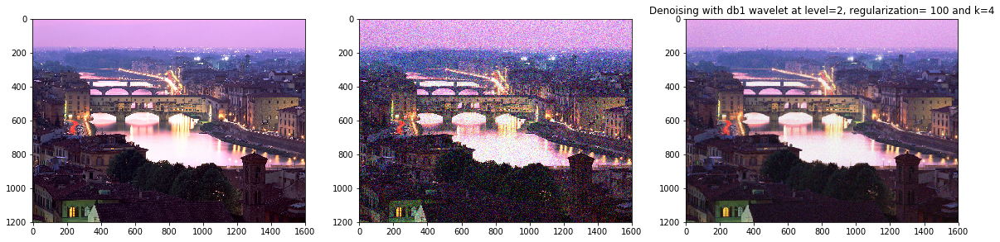

In [46]:
mode="db1"
level=2
regularizations=[0.01,1,10,100]
ks=[2,3,4]
optim_value=[]
for k in ks:
    for regularization in regularizations:
        Image_recover=denoise(imagewithnoise,mode,level,k,regularization)
        compare(image,imagewithnoise,Image_recover,make_title(mode,level,regularization,k))
        optim_value.append(np.sqrt(np.sum((image-Image_recover)**2)))
        

## Final model

When I compare the sum of squared errors between the original image and the denoising one, I see that the best model is the one with the db1 wavelet with level of decoposition at 2, a regularizator parameter fixed at 10 and a value of 2 for the proximator parameter. Nevertheles, there are other models that offer also a good solution. 

In [51]:
print(optim_value)
print(np.argmin(optim_value))

[23196.353851413805, 20537.75235998331, 19585.21018523927, 19630.344113132607, 21874.202225452704, 19631.963121399756, 19602.876906209454, 19624.276649089516, 20206.543964765475, 19608.761893602565, 19611.571150726297, 19622.103429551073]
2


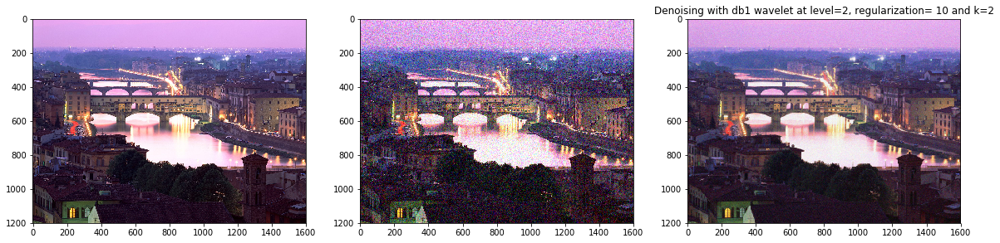

In [53]:
mode="db1"
level=2
regularization=10
k=2
Image_recover=denoise(imagewithnoise,mode,level,k,regularization)
compare(image,imagewithnoise,Image_recover,make_title(mode,level,regularization,k))